<a href="https://colab.research.google.com/github/Natural-Language-Processing-YU/M3_Assignment/blob/main/scripts/m3_assignment_part_III.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Gender Preds BERT Classifier-part3
Using the previous two tutorials, please answer the following using an encorder-decoder approach and an LSTM compared approach. 

Please create a transformer-based classifier for English name classification into male or female.

There are several datasets for name for male or female classification. In subseuqent iterations, this could be expanded to included more classifications. 

Below is the source from NLTK, which only has male and female available but could be used for the purposes of this assignment. 

```
names = nltk.corpus.names
names.fileids()
['female.txt', 'male.txt']
male_names = names.words('male.txt')
female_names = names.words('female.txt')
[w for w in male_names if w in female_names]
['Abbey', 'Abbie', 'Abby', 'Addie', 'Adrian', 'Adrien', 'Ajay', 'Alex', 'Alexis',
'Alfie', 'Ali', 'Alix', 'Allie', 'Allyn', 'Andie', 'Andrea', 'Andy', 'Angel',
'Angie', 'Ariel', 'Ashley', 'Aubrey', 'Augustine', 'Austin', 'Averil', ...]
```

reference: https://maelfabien.github.io/machinelearning/NLP_7/#data-pre-processing, assignment_4_part2

In [6]:
pip install sklearn

Note: you may need to restart the kernel to use updated packages.


In [7]:
#!pip install transformers

In [8]:
#pip install nltk

In [9]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
import nltk
import numpy as np
import collections
import logging
import os
import pathlib
import re
import string
import sys
import time

import numpy as np
import matplotlib.pyplot as plt

import tensorflow_datasets as tfds
import tensorflow_text as text
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Bidirectional, LSTM, Dropout, Dense, Activation
from tensorflow.keras.regularizers import l2
from tensorflow.keras.models import Sequential
from transformers import BertTokenizer
from transformers import BertTokenizer, TFBertForSequenceClassification
import sklearn
from sklearn.model_selection import train_test_split


### 1.1 Prepare Data

In [10]:
# loading Datasets
nltk.download('names')

names = nltk.corpus.names

names.fileids()
# Get male and female names
male_names = names.words('male.txt')
male_names = [i.lower() for i in male_names]
female_names = names.words('female.txt')
female_names = [i.lower() for i in female_names]

# Create labeled examples with class labels
male_labeled = [(name, 'male') for name in male_names]
female_labeled = [(name, 'female') for name in female_names]



# Combine the datasets
labeled_data = male_labeled + female_labeled

[nltk_data] Downloading package names to
[nltk_data]     C:\Users\xxian\AppData\Roaming\nltk_data...
[nltk_data]   Package names is already up-to-date!


### check out the base line: the distribution of female and male

In [11]:
len(male_labeled)/(len(female_labeled)+len(male_labeled))

0.3704682779456193

## Using LSTM

### create vocab

In [12]:
names_list=[i.lower() for i in names.words()]
names_list[:3]

['abagael', 'abagail', 'abbe']

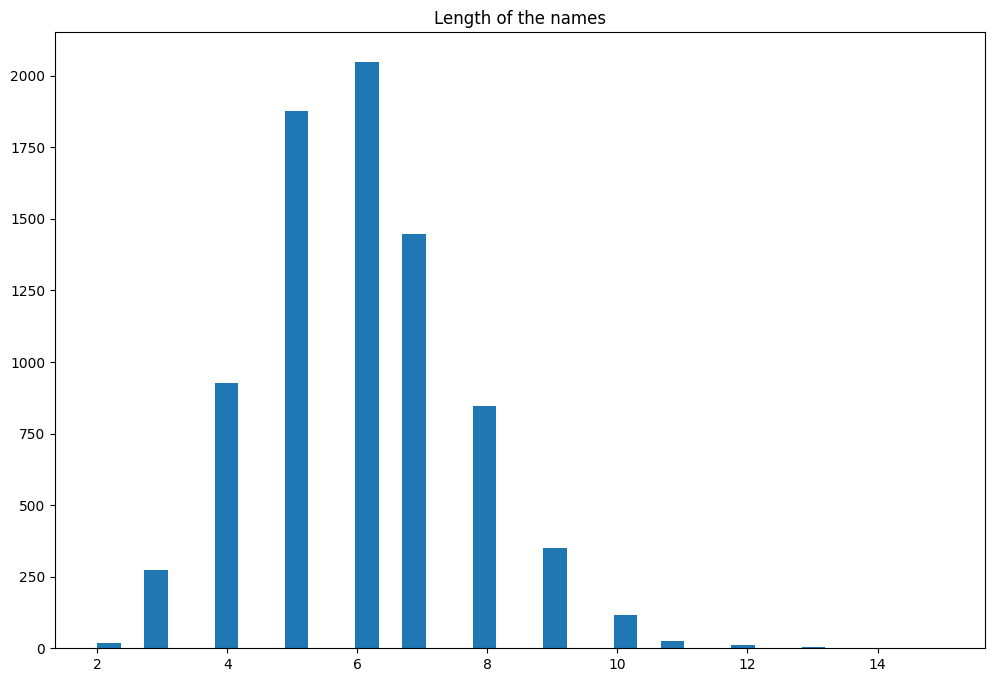

In [13]:
plt.figure(figsize=(12,8))
plt.hist([len(a) for a in names.words()], bins=36)
plt.title("Length of the names")
plt.show()

In [14]:
maxlen = 15
labels = 2

vocab

In [15]:
vocab = set(' '.join([str(i) for i in names_list]))
vocab.add('END')
len_vocab = len(vocab)
vocab,len(vocab)

({' ',
  "'",
  '-',
  'END',
  'a',
  'b',
  'c',
  'd',
  'e',
  'f',
  'g',
  'h',
  'i',
  'j',
  'k',
  'l',
  'm',
  'n',
  'o',
  'p',
  'q',
  'r',
  's',
  't',
  'u',
  'v',
  'w',
  'x',
  'y',
  'z'},
 30)

char to index

In [16]:
char_index = dict((c, i) for i, c in enumerate(vocab))
char_index


{'y': 0,
 'u': 1,
 ' ': 2,
 'j': 3,
 'd': 4,
 'z': 5,
 'w': 6,
 'f': 7,
 'm': 8,
 'n': 9,
 '-': 10,
 'x': 11,
 'k': 12,
 'i': 13,
 'r': 14,
 't': 15,
 'b': 16,
 'g': 17,
 'o': 18,
 'c': 19,
 "'": 20,
 'q': 21,
 'e': 22,
 'p': 23,
 'a': 24,
 'h': 25,
 'v': 26,
 'END': 27,
 's': 28,
 'l': 29}

In [17]:
X = []
y = []

# Builds an empty line with a 1 at the index of character
def set_flag(i):
    tmp = np.zeros(len_vocab);
    tmp[i] = 1
    return list(tmp)

# Truncate names and create the matrix
def prepare_X(X):
    new_list = []
    trunc_train_name = [str(i)[0:maxlen] for i in X]

    for i in trunc_train_name:
        tmp = [set_flag(char_index[j]) for j in str(i)]
        for k in range(0,maxlen - len(str(i))):
            tmp.append(set_flag(char_index["END"]))
        new_list.append(tmp)

    return new_list


X = prepare_X(names_list)

# Label Encoding of y
def prepare_y(y):
    new_list = []
    for i in y:
        if i in male_names:
            new_list.append([1,0])
        else:
            new_list.append([0,1])

    return new_list

y = prepare_y(names_list)

In [18]:
X_train, X_test, y_train, y_test = train_test_split(X, y)

In [50]:
X

[[[0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   1.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0],
  [0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   1.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0],
  [0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   1.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0],
  [0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   1.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0,
   0.0],
  [0.0,
   0.0,
   0.0,
   0.0,
   0

In [44]:
y

([[0, 1],
  [0, 1],
  [0, 1],
  [1, 0],
  [0, 1],
  [1, 0],
  [1, 0],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [1, 0],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [1, 0],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [1, 0],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [1, 0],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],
  [0, 1],


In [19]:
LSTM_model = Sequential()
LSTM_model.add(Bidirectional(LSTM(512, return_sequences=True), backward_layer=LSTM(512, return_sequences=True, go_backwards=True), input_shape=(maxlen,len_vocab)))
LSTM_model.add(Dropout(0.2))
LSTM_model.add(Bidirectional(LSTM(512)))
LSTM_model.add(Dropout(0.2))
LSTM_model.add(Dense(2, activity_regularizer=l2(0.002)))
LSTM_model.add(Activation('softmax'))
LSTM_model.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])

LSTM_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirectiona  (None, 15, 1024)         2224128   
 l)                                                              
                                                                 
 dropout (Dropout)           (None, 15, 1024)          0         
                                                                 
 bidirectional_1 (Bidirectio  (None, 1024)             6295552   
 nal)                                                            
                                                                 
 dropout_1 (Dropout)         (None, 1024)              0         
                                                                 
 dense (Dense)               (None, 2)                 2050      
                                                                 
 activation (Activation)     (None, 2)                

In [20]:
callback = EarlyStopping(monitor='val_loss', patience=5)
mc = ModelCheckpoint('best_model_9.h5', monitor='val_loss', mode='min', verbose=1)
reduce_lr_acc = ReduceLROnPlateau(monitor='val_accuracy', factor=0.1, patience=2, verbose=1, min_delta=1e-4, mode='max')

In [21]:
batch_size = 128
history = LSTM_model.fit(X_train, y_train, batch_size=batch_size, epochs=35, verbose=1, validation_data =(X_test, y_test), callbacks=[callback, mc, reduce_lr_acc])

Epoch 1/35
47/47 [==============================] - ETA: 0s - loss: 0.6108 - accuracy: 0.6591
Epoch 1: saving model to best_model_9.h5
47/47 [==============================] - 15s 104ms/step - loss: 0.6108 - accuracy: 0.6591 - val_loss: 0.5587 - val_accuracy: 0.7185 - lr: 0.0010
Epoch 2/35
45/47 [===========================>..] - ETA: 0s - loss: 0.5184 - accuracy: 0.7457
Epoch 2: saving model to best_model_9.h5
47/47 [==============================] - 1s 25ms/step - loss: 0.5185 - accuracy: 0.7449 - val_loss: 0.5108 - val_accuracy: 0.7623 - lr: 0.0010
Epoch 3/35
46/47 [============================>.] - ETA: 0s - loss: 0.4943 - accuracy: 0.7597
Epoch 3: saving model to best_model_9.h5
47/47 [==============================] - 1s 27ms/step - loss: 0.4934 - accuracy: 0.7603 - val_loss: 0.4828 - val_accuracy: 0.7704 - lr: 0.0010
Epoch 4/35
47/47 [==============================] - ETA: 0s - loss: 0.4711 - accuracy: 0.7652
Epoch 4: saving model to best_model_9.h5
47/47 [======================

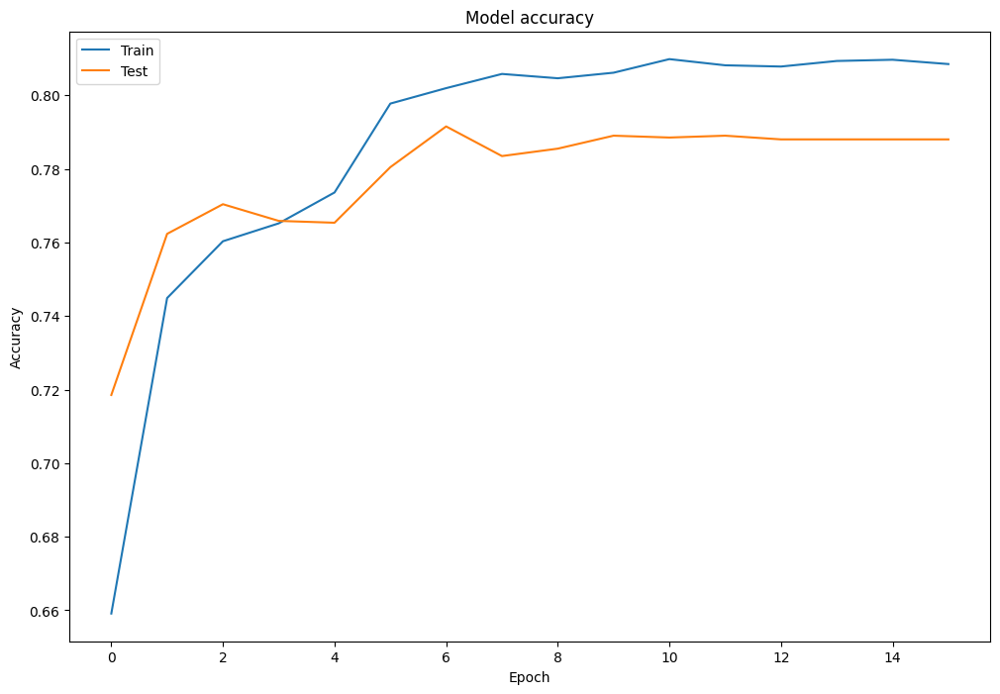

In [22]:
plt.figure(figsize=(12,8))
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [29]:
new_names = ["mael", "jenny", "marc"]
X_pred = prepare_X(new_names)

In [31]:
prediction = LSTM_model.predict(X_pred)
prediction

1/1 [==============================] - 1s 620ms/step


array([[0.4701204 , 0.5298796 ],
       [0.33548808, 0.66451186],
       [0.787662  , 0.21233797]], dtype=float32)

In [41]:
def pred(new_names, prediction, dict_answer):
    return_results = []
    k = 0
    for i in prediction:
            # np.argmax(i)give the index of the max value in the array，
            # input i=[0.787662  , 0.21233797] output 0
        return_results.append([new_names[k], dict_answer[np.argmax(i)]])
        k += 1
    return return_results

In [42]:
dict_answer = {
    0: "male",
    1: "female"
}

In [43]:
pred(new_names, prediction, dict_answer)

[['mael', 'female'], ['jenny', 'female'], ['marc', 'male']]

END of LSTM

## Using Bert

In [6]:
labeled_data

[('aamir', 'male'),
 ('aaron', 'male'),
 ('abbey', 'male'),
 ('abbie', 'male'),
 ('abbot', 'male'),
 ('abbott', 'male'),
 ('abby', 'male'),
 ('abdel', 'male'),
 ('abdul', 'male'),
 ('abdulkarim', 'male'),
 ('abdullah', 'male'),
 ('abe', 'male'),
 ('abel', 'male'),
 ('abelard', 'male'),
 ('abner', 'male'),
 ('abraham', 'male'),
 ('abram', 'male'),
 ('ace', 'male'),
 ('adair', 'male'),
 ('adam', 'male'),
 ('adams', 'male'),
 ('addie', 'male'),
 ('adger', 'male'),
 ('aditya', 'male'),
 ('adlai', 'male'),
 ('adnan', 'male'),
 ('adolf', 'male'),
 ('adolfo', 'male'),
 ('adolph', 'male'),
 ('adolphe', 'male'),
 ('adolpho', 'male'),
 ('adolphus', 'male'),
 ('adrian', 'male'),
 ('adrick', 'male'),
 ('adrien', 'male'),
 ('agamemnon', 'male'),
 ('aguinaldo', 'male'),
 ('aguste', 'male'),
 ('agustin', 'male'),
 ('aharon', 'male'),
 ('ahmad', 'male'),
 ('ahmed', 'male'),
 ('ahmet', 'male'),
 ('ajai', 'male'),
 ('ajay', 'male'),
 ('al', 'male'),
 ('alaa', 'male'),
 ('alain', 'male'),
 ('alan', 'male

Train-Test Split

In [7]:
from sklearn.model_selection import train_test_split
train_set, test_set = train_test_split(labeled_data,
                                       test_size=0.1,
                                       random_state=42)
print(len(train_set), len(test_set))

7149 795


In [8]:
X_train_text = [[letters for letters in text] for (text, label) in train_set]
y_train = [1 if label == 'male' else 0 for text, label in train_set]

X_test_text = [[letters for letters in text] for (text, label) in test_set]
y_test = [1 if label == 'male' else 0 for text, label in test_set]


In [46]:
X_train_text

[['j', 'a', 'y', 'n', 'e', 'l', 'l'],
 ['s', 'a', 'y', 'r', 'e'],
 ['e', 't', 'h', 'e', 'l', 'r', 'e', 'd'],
 ['f', 'r', 'e', 'd', 'a'],
 ['h', 'a', 'l', 'i', 'm', 'e', 'd', 'a'],
 ['t', 'h', 'u', 'r', 's', 't', 'o', 'n'],
 ['l', 'i', 'n', 'o', 'e', 'l'],
 ['l', 'y', 'n', 'd', 'o', 'n'],
 ['r', 'a', 'n', 'd', 'y'],
 ['s', 'a', 's', 'h', 'e', 'n', 'k', 'a'],
 ['n', 'i', 'c', 'o'],
 ['c', 'l', 'a', 'y', 't', 'o', 'n'],
 ['d', 'o', 'l', 'l', 'i'],
 ['a', 'u', 's', 't', 'e', 'n'],
 ['g', 'a', 'r', 'r', 'o', 't', 't'],
 ['t', 'r', 'i', 'x', 'i', 'e'],
 ['h', 'y', 'm', 'a', 'n'],
 ['e', 'l', 'e', 'n', 'i'],
 ['l', 'o', 'c', 'k', 'w', 'o', 'o', 'd'],
 ['s', 't', 'e', 'f', 'a'],
 ['b', 'r', 'o', 'o', 'k'],
 ['h', 'i', 'l', 'l', 'i', 'a', 'r', 'd'],
 ['c', 'o', 'r', 'e', 'e', 'n'],
 ['h', 'i', 'n', 'd', 'a'],
 ['h', 'a', 'r', 'l', 'e', 'n', 'e'],
 ['j', 'a', 'n', 'n', 'e', 'l'],
 ['m', 'a', 'v', 'i', 's'],
 ['r', 'o', 'i', 'c', 'e'],
 ['j', 'e', 'p', 'h', 't', 'h', 'a', 'h'],
 ['e', 'd', 'm', '

From Text to BERT Input

In [9]:
bert_tokenizer = BertTokenizer.from_pretrained("bert-base-uncased", do_lower_case=True)

In [10]:
y_train = np.array(y_train)
y_test = np.array(y_test)

In [47]:
# Find the longest list using max with a custom key
longest_list = max(X_train_text, key=len)

print("Longest List:", longest_list)
print("Length of Longest List:", len(longest_list))

Longest List: ['j', 'e', 'a', 'n', '-', 'c', 'h', 'r', 'i', 's', 't', 'o', 'p', 'h', 'e']
Length of Longest List: 15


In [11]:
#     combine step for tokenization, 
#     WordPiece vector mapping, 
#     adding special tokens as well as 
#     truncating reviews longer than the max length 

def convert_example_to_feature(review):
  return bert_tokenizer.encode_plus(review, 
                add_special_tokens = True,     # add [CLS], [SEP]
                max_length = 15,              # max length of the text that can go to BERT
                padding='max_length',
                truncation=True,
                return_attention_mask = True,  # add attention mask to not focus on pad tokens
              )

In [12]:
# map to the expected input to TFBertForSequenceClassification
def map_example_to_dict(input_ids, attention_masks, token_type_ids, label):
  return {
      "input_ids": input_ids,
      "token_type_ids": token_type_ids,
      "attention_mask": attention_masks,
  }, label

def encode_examples(ds):
  # prepare list, so that we can build up final TensorFlow dataset from slices.
  input_ids_list = []
  token_type_ids_list = []
  attention_mask_list = []
  label_list = []
  for review, label in ds:
    bert_input = convert_example_to_feature(review)
    input_ids_list.append(bert_input['input_ids'])
    token_type_ids_list.append(bert_input['token_type_ids'])
    attention_mask_list.append(bert_input['attention_mask'])
    label_list.append([label])

  return tf.data.Dataset.from_tensor_slices((input_ids_list, attention_mask_list, token_type_ids_list, label_list)).map(map_example_to_dict)

In [13]:
# hyper-parameters
batch_size = 8

In [14]:
# train dataset
ds_train = zip(X_train_text, y_train)
ds_test = zip(X_test_text, y_test)
ds_train_encoded = encode_examples(ds_train).shuffle(len(X_train_text)).batch(batch_size)
ds_test_encoded = encode_examples(ds_test).batch(batch_size)

In [15]:
num_classes=2

### Load Bert model

In [16]:
## Initialize pre-built BERT-based classifier from transformers
bert_model = TFBertForSequenceClassification.from_pretrained(
    'bert-base-uncased', num_labels=num_classes)

bert_model.summary()

All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Model: "tf_bert_for_sequence_classification"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bert (TFBertMainLayer)      multiple                  109482240 
                                                                 
 dropout_37 (Dropout)        multiple                  0         
                                                                 
 classifier (Dense)          multiple                  1538      
                                                                 
Total params: 109,483,778
Trainable params: 109,483,778
Non-trainable params: 0
_________________________________________________________________


### Set hyperprameters and Opitmier

In [26]:
# recommended learning rate for Adam 5e-5, 3e-5, 2e-5
learning_rate = 2e-5
# multiple epochs might be better as long as we will not overfit the model
number_of_epochs = 5

# choosing Adam optimizer
optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, epsilon=1e-08)
# we do not have one-hot vectors, we can use sparce categorical cross entropy and accuracy
loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
metric = tf.keras.metrics.SparseCategoricalAccuracy('accuracy')

bert_model.compile(loss=loss,
                   optimizer=optimizer,
                   metrics=metric)

In [27]:
history = bert_model.fit(ds_train_encoded,
                         batch_size=batch_size,
                         epochs=number_of_epochs,
                         validation_data=ds_test_encoded)

Epoch 1/5


894/894 [==============================] - 154s 164ms/step - loss: 0.4249 - accuracy: 0.7947 - val_loss: 0.4447 - val_accuracy: 0.7899
Epoch 2/5
894/894 [==============================] - 143s 160ms/step - loss: 0.3949 - accuracy: 0.8151 - val_loss: 0.4302 - val_accuracy: 0.7836
Epoch 3/5
894/894 [==============================] - 143s 159ms/step - loss: 0.3583 - accuracy: 0.8299 - val_loss: 0.4264 - val_accuracy: 0.8138
Epoch 4/5
894/894 [==============================] - 142s 159ms/step - loss: 0.3245 - accuracy: 0.8533 - val_loss: 0.4222 - val_accuracy: 0.8025
Epoch 5/5
894/894 [==============================] - 141s 158ms/step - loss: 0.2943 - accuracy: 0.8678 - val_loss: 0.4149 - val_accuracy: 0.8239


Plot

In [28]:
import matplotlib.pyplot as plt
import matplotlib
import pandas as pd

matplotlib.rcParams['figure.dpi'] = 150


# Plotting results
def plot1(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs = range(1, len(acc) + 1)
    ## Accuracy plot
    plt.plot(epochs, acc, 'bo', label='Training acc')
    plt.plot(epochs, val_acc, 'b', label='Validation acc')
    plt.title('Training and validation accuracy')
    plt.legend()
    ## Loss plot
    plt.figure()

    plt.plot(epochs, loss, 'bo', label='Training loss')
    plt.plot(epochs, val_loss, 'b', label='Validation loss')
    plt.title('Training and validation loss')
    plt.legend()
    plt.show()


def plot2(history):
    pd.DataFrame(history.history).plot(figsize=(8, 5))
    plt.grid(True)
    #plt.gca().set_ylim(0,1)
    plt.show()

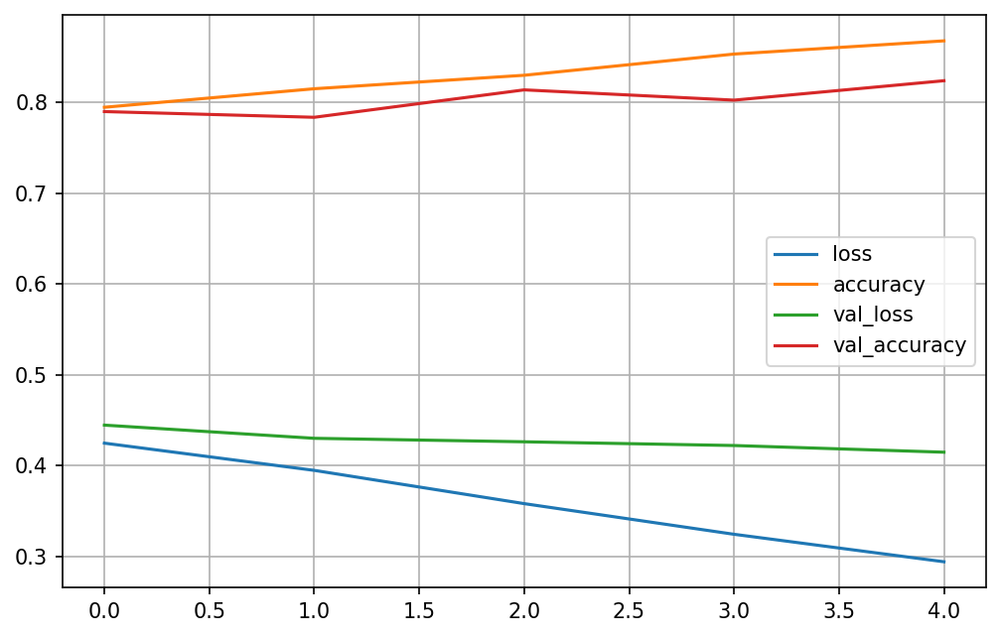

In [29]:
plot2(history)

### Save Model(Model wirghts and tokenizier in pretrain folder)

In [30]:
# Save the BERT model to the specified path
model_save_path = r'C:\Users\xxian\Desktop\Code Program\Summer_NLP\Bert\model\bert_model.h5'
bert_model.save_pretrained(model_save_path)

# Save the tokenizer to the specified path
tokenizer_save_path = r'C:\Users\xxian\Desktop\Code Program\Summer_NLP\Bert\model\tokenizer'
bert_tokenizer.save_pretrained(tokenizer_save_path)

('C:\\Users\\xxian\\Desktop\\Code Program\\Summer_NLP\\Bert\\model\\tokenizer\\tokenizer_config.json',
 'C:\\Users\\xxian\\Desktop\\Code Program\\Summer_NLP\\Bert\\model\\tokenizer\\special_tokens_map.json',
 'C:\\Users\\xxian\\Desktop\\Code Program\\Summer_NLP\\Bert\\model\\tokenizer\\vocab.txt',
 'C:\\Users\\xxian\\Desktop\\Code Program\\Summer_NLP\\Bert\\model\\tokenizer\\added_tokens.json')

### Load Model

In [20]:
# from transformers import TFBertForSequenceClassification, BertTokenizer

# # Load the BERT model
# bert_model = TFBertForSequenceClassification.from_pretrained(model_save_path)

# # Load the tokenizer
# tokenizer = BertTokenizer.from_pretrained(tokenizer_save_path)

Some layers from the model checkpoint at C:\Users\xxian\Desktop\Code Program\Summer_NLP\Bert\model\bert_model.h5 were not used when initializing TFBertForSequenceClassification: ['dropout_37']
- This IS expected if you are initializing TFBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFBertForSequenceClassification were initialized from the model checkpoint at C:\Users\xxian\Desktop\Code Program\Summer_NLP\Bert\model\bert_model.h5.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertForSequenceClassification for predi

### Prediction

In [31]:
text='aamir'
def text_process(text):
    return [char for char in text]
text_input=text_process(text)

In [32]:
# Function to predict gender (male or female) from text
def predict_gender(text):
    # Tokenize the input text and convert to tensor
    inputs = bert_tokenizer(text, padding=True, truncation=True, return_tensors="tf")
    # Make prediction using the BERT model
    predictions = bert_model(inputs)
    # Extract the predicted label (1 for male, 0 for female)
    predicted_label = tf.argmax(predictions.logits, axis=1).numpy()[0]
    # Return the predicted gender
    if predicted_label == 1:
        return "male"
    else:
        return "female"

In [33]:
predict_gender(text_input)

'female'

### Evaluation

In [35]:
def plot_confusion_matrix(cm,
                          target_names,
                          title='Confusion matrix',
                          cmap=None,
                          normalize=True):
    """
    given a sklearn confusion matrix (cm), make a nice plot

    Arguments
    ---------
    cm:           confusion matrix from sklearn.metrics.confusion_matrix

    target_names: given classification classes such as [0, 1, 2]
                  the class names, for example: ['high', 'medium', 'low']

    title:        the text to display at the top of the matrix

    cmap:         the gradient of the values displayed from matplotlib.pyplot.cm
                  see http://matplotlib.org/examples/color/colormaps_reference.html
                  plt.get_cmap('jet') or plt.cm.Blues

    normalize:    If False, plot the raw numbers
                  If True, plot the proportions

    Usage
    -----
    plot_confusion_matrix(cm           = cm,                  # confusion matrix created by
                                                              # sklearn.metrics.confusion_matrix
                          normalize    = True,                # show proportions
                          target_names = y_labels_vals,       # list of names of the classes
                          title        = best_estimator_name) # title of graph

    Citiation
    ---------
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html

    """
    import matplotlib.pyplot as plt
    import numpy as np
    import itertools

    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    if cmap is None:
        cmap = plt.get_cmap('Blues')

    plt.figure(figsize=(8, 6), dpi=150)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()

    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 1.5 if normalize else cm.max() / 2
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if normalize:
            plt.text(j,
                     i,
                     "{:0.4f}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")
        else:
            plt.text(j,
                     i,
                     "{:,}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label\naccuracy={:0.4f}; misclass={:0.4f}'.format(
        accuracy, misclass))
    plt.show()

In [39]:
bert_model.evaluate(ds_test_encoded,
                    batch_size=batch_size)
y_test_pred = bert_model.predict(ds_test_encoded,
                                 batch_size=batch_size)

# 
y_test_pred_class = y_test_pred[0].argmax(axis=1)

100/100 [==============================] - 6s 50ms/step


In [43]:
y_test_pred

TFSequenceClassifierOutput(loss=None, logits=array([[-2.3742404 ,  2.3984737 ],
       [-2.3388155 ,  2.120963  ],
       [ 2.4489462 , -2.272698  ],
       ...,
       [-1.271711  ,  0.74347955],
       [ 2.5513077 , -2.333129  ],
       [-2.1276827 ,  2.3542085 ]], dtype=float32), hidden_states=None, attentions=None)

In [40]:
cm = sklearn.metrics.confusion_matrix(y_test,
                                      y_test_pred_class,
                                      normalize=None)

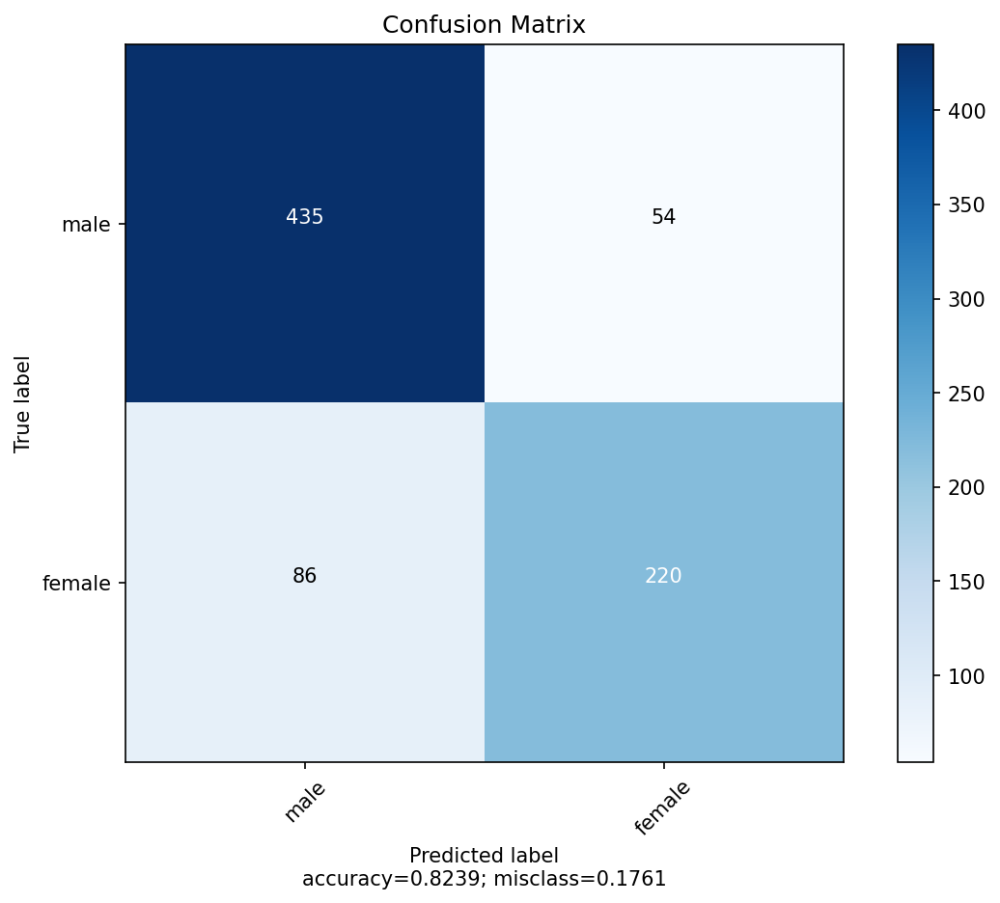

In [48]:
plot_confusion_matrix(cm,
                      normalize=False,
                      target_names=['male', 'female'],
                      title="Confusion Matrix")

end

## Using Transformer

In [16]:
padded_sequences

array([[ 101,  100, 1037, ...,    0,    0,    0],
       [ 101,  100, 1037, ...,    0,    0,    0],
       [ 101,  100, 1038, ...,    0,    0,    0],
       ...,
       [ 101,  100, 1055, ...,    0,    0,    0],
       [ 101,  100, 1057, ...,    0,    0,    0],
       [ 101,  100, 1057, ...,    0,    0,    0]])

### 1.2 Words to same lentgh sequence

In [ ]:
# Tokenize the names
tokenizer = Tokenizer()

# Fit tokenizer on the names
tokenizer.fit_on_texts([[letters for letters in name] for name, label in labeled_data])

# Create sequences
sequences = tokenizer.texts_to_sequences([[letters for letters in name] for name, label in labeled_data])

# Pad sequences to make them of the same length, some names have two words
max_length = max(len(seq) for seq in sequences)# max length of a name is 2
padded_sequences = pad_sequences(sequences, maxlen=max_length, padding='post')

# Create input and target data (use same data for both in encoder-decoder approach)
input_data = padded_sequences
#target_data = padded_sequences
target_data = [[1] if label == 'male' else [0] for name, label in labeled_data]  # 1 for male, 0 for female
target_data = np.array(target_data)

In [ ]:
# Split the data into train and test sets
train_size = int(0.8 * len(input_data))
X_train, X_test = input_data[:train_size], input_data[train_size:]
y_train, y_test = target_data[:train_size], target_data[train_size:]

In [ ]:
len(input_data),len(target_data)

(7944, 7944)

In [ ]:
X_train, X_test,y_train, y_test

(array([[ 1,  1, 11, ...,  0,  0,  0],
        [ 1,  1,  5, ...,  0,  0,  0],
        [ 1, 15, 15, ...,  0,  0,  0],
        ...,
        [11,  1,  5, ...,  0,  0,  0],
        [11,  1,  5, ...,  0,  0,  0],
        [11,  1,  5, ...,  0,  0,  0]]),
 array([[11,  1,  5, ...,  0,  0,  0],
        [11,  1,  5, ...,  0,  0,  0],
        [11,  1,  5, ...,  0,  0,  0],
        ...,
        [24,  9,  1, ...,  0,  0,  0],
        [24, 16,  6, ...,  0,  0,  0],
        [24, 16, 24, ...,  0,  0,  0]]),
 array([[1],
        [1],
        [1],
        ...,
        [0],
        [0],
        [0]]),
 array([[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]]))

In [ ]:
m=X_train
target_tensor = tf.convert_to_tensor(m, dtype=tf.int32)
target_tensor

<tf.Tensor: shape=(6355, 15), dtype=int32, numpy=
array([[ 1,  1, 11, ...,  0,  0,  0],
       [ 1,  1,  5, ...,  0,  0,  0],
       [ 1, 15, 15, ...,  0,  0,  0],
       ...,
       [11,  1,  5, ...,  0,  0,  0],
       [11,  1,  5, ...,  0,  0,  0],
       [11,  1,  5, ...,  0,  0,  0]])>

In [ ]:
# Get the word index from the tokenizer
word_index = tokenizer.word_index

# Calculate the vocabulary size (number of unique words)
vocab_size = len(word_index)

word_index, vocab_size

({'a': 1,
  'e': 2,
  'i': 3,
  'n': 4,
  'r': 5,
  'l': 6,
  'o': 7,
  't': 8,
  's': 9,
  'd': 10,
  'm': 11,
  'y': 12,
  'h': 13,
  'c': 14,
  'b': 15,
  'u': 16,
  'g': 17,
  'k': 18,
  'j': 19,
  'v': 20,
  'f': 21,
  'p': 22,
  'w': 23,
  'z': 24,
  'x': 25,
  'q': 26,
  '-': 27,
  ' ': 28,
  "'": 29},
 29)

tokenization

In [ ]:
def tokenize_pairs(names, genders):
    # Tokenize the names
    tokenizer = Tokenizer()

    # Fit tokenizer on the names
    tokenizer.fit_on_texts([[letters for letters in name] for name in names])
    # Create sequences
    sequences = tokenizer.texts_to_sequences([[letters for letters in name] for name in names])
    # Pad sequences to make them of the same length, some names have two words
    max_length = max(len(seq) for seq in sequences)# max length of a name is 2
    padded_sequences = pad_sequences(sequences, maxlen=max_length, padding='post')
    # Create input and target data (use same data for both in encoder-decoder approach)
    names = padded_sequences.to_tensor()
    names = tf.convert_to_tensor(names, dtype=tf.int32)


    #target_data = padded_sequences
    target_data = [[1] if label == 'male' else [0] for label in genders]  # 1 for male, 0 for female
    target_data = np.array(target_data)
    target_data = target_data.to_tensor()
    genders = tf.convert_to_tensor(target_data, dtype=tf.int32)

    return names, genders

batches？？？？

In [ ]:
BUFFER_SIZE = 20000
BATCH_SIZE = 64

In [ ]:
def make_batches(ds):
  return (
      ds
      .cache()
      .shuffle(BUFFER_SIZE)
      .batch(BATCH_SIZE)
      .map(tokenize_pairs, num_parallel_calls=tf.data.AUTOTUNE)
      .prefetch(tf.data.AUTOTUNE))


### 1.3 building Transformer

Position embedding


In [ ]:
def get_angles(pos, i, d_model):
  angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
  return pos * angle_rates

In [ ]:
def positional_encoding(position, d_model):
  angle_rads = get_angles(np.arange(position)[:, np.newaxis],
                          np.arange(d_model)[np.newaxis, :],
                          d_model)

  # apply sin to even indices in the array; 2i
  angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])

  # apply cos to odd indices in the array; 2i+1
  angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])

  pos_encoding = angle_rads[np.newaxis, ...]

  return tf.cast(pos_encoding, dtype=tf.float32)

Mask

In [ ]:
def create_padding_mask(seq):
  seq = tf.cast(tf.math.equal(seq, 0), tf.float32)

  # add extra dimensions to add the padding
  # to the attention logits.
  return seq[:, tf.newaxis, tf.newaxis, :]  # (batch_size, 1, 1, seq_len)

look-ahead mask for the decoder

In [ ]:
def create_look_ahead_mask(size):
  mask = 1 - tf.linalg.band_part(tf.ones((size, size)), -1, 0)
  return mask  # (seq_len, seq_len)

multi-head attention

In [ ]:
class MultiHeadAttention(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads):
    super(MultiHeadAttention, self).__init__()
    self.num_heads = num_heads
    self.d_model = d_model

    assert d_model % self.num_heads == 0

    self.depth = d_model // self.num_heads

    self.wq = tf.keras.layers.Dense(d_model)
    self.wk = tf.keras.layers.Dense(d_model)
    self.wv = tf.keras.layers.Dense(d_model)

    self.dense = tf.keras.layers.Dense(d_model)

  def split_heads(self, x, batch_size):
    """Split the last dimension into (num_heads, depth).
    Transpose the result such that the shape is (batch_size, num_heads, seq_len, depth)
    """
    x = tf.reshape(x, (batch_size, -1, self.num_heads, self.depth))
    return tf.transpose(x, perm=[0, 2, 1, 3])

  def call(self, v, k, q, mask):
    batch_size = tf.shape(q)[0]

    q = self.wq(q)  # (batch_size, seq_len, d_model)
    k = self.wk(k)  # (batch_size, seq_len, d_model)
    v = self.wv(v)  # (batch_size, seq_len, d_model)

    q = self.split_heads(q, batch_size)  # (batch_size, num_heads, seq_len_q, depth)
    k = self.split_heads(k, batch_size)  # (batch_size, num_heads, seq_len_k, depth)
    v = self.split_heads(v, batch_size)  # (batch_size, num_heads, seq_len_v, depth)

    # scaled_attention.shape == (batch_size, num_heads, seq_len_q, depth)
    # attention_weights.shape == (batch_size, num_heads, seq_len_q, seq_len_k)
    scaled_attention, attention_weights = scaled_dot_product_attention(
        q, k, v, mask)

    scaled_attention = tf.transpose(scaled_attention, perm=[0, 2, 1, 3])  # (batch_size, seq_len_q, num_heads, depth)

    concat_attention = tf.reshape(scaled_attention,
                                  (batch_size, -1, self.d_model))  # (batch_size, seq_len_q, d_model)

    output = self.dense(concat_attention)  # (batch_size, seq_len_q, d_model)

    return output, attention_weights

point wise feed forward network

In [ ]:
def point_wise_feed_forward_network(d_model, dff):
  return tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),  # (batch_size, seq_len, dff)
      tf.keras.layers.Dense(d_model)  # (batch_size, seq_len, d_model)
  ])

encoder: embedding, position embedding, multi head attention, point wise feed forward network

In [ ]:
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(EncoderLayer, self).__init__()

    self.mha = MultiHeadAttention(d_model, num_heads)
    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)

    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)

  def call(self, x, training, mask):

    attn_output, _ = self.mha(x, x, x, mask)  # (batch_size, input_seq_len, d_model)
    attn_output = self.dropout1(attn_output, training=training)
    out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)

    ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
    ffn_output = self.dropout2(ffn_output, training=training)
    out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)

    return out2

In [ ]:
class Encoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff, input_vocab_size,
               maximum_position_encoding, rate=0.1):
    super(Encoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers

    self.embedding = tf.keras.layers.Embedding(input_vocab_size, d_model)
    self.pos_encoding = positional_encoding(maximum_position_encoding,
                                            self.d_model)

    self.enc_layers = [EncoderLayer(d_model, num_heads, dff, rate)
                       for _ in range(num_layers)]

    self.dropout = tf.keras.layers.Dropout(rate)

  def call(self, x, training, mask):

    seq_len = tf.shape(x)[1]

    # adding embedding and position encoding.
    x = self.embedding(x)  # (batch_size, input_seq_len, d_model)
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))
    x += self.pos_encoding[:, :seq_len, :]

    x = self.dropout(x, training=training)

    for i in range(self.num_layers):
      x = self.enc_layers[i](x, training, mask)

    return x  # (batch_size, input_seq_len, d_model)

decoder: embedding, position embedding, 2 multihead attention and 2 feed forward network

In [ ]:
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(DecoderLayer, self).__init__()

    self.mha1 = MultiHeadAttention(d_model, num_heads)
    self.mha2 = MultiHeadAttention(d_model, num_heads)

    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)

    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    self.dropout3 = tf.keras.layers.Dropout(rate)

  def call(self, x, enc_output, training,
           look_ahead_mask, padding_mask):
    # enc_output.shape == (batch_size, input_seq_len, d_model)

    attn1, attn_weights_block1 = self.mha1(x, x, x, look_ahead_mask)  # (batch_size, target_seq_len, d_model)
    attn1 = self.dropout1(attn1, training=training)
    out1 = self.layernorm1(attn1 + x)

    attn2, attn_weights_block2 = self.mha2(
        enc_output, enc_output, out1, padding_mask)  # (batch_size, target_seq_len, d_model)
    attn2 = self.dropout2(attn2, training=training)
    out2 = self.layernorm2(attn2 + out1)  # (batch_size, target_seq_len, d_model)

    ffn_output = self.ffn(out2)  # (batch_size, target_seq_len, d_model)
    ffn_output = self.dropout3(ffn_output, training=training)
    out3 = self.layernorm3(ffn_output + out2)  # (batch_size, target_seq_len, d_model)

    return out3, attn_weights_block1, attn_weights_block2

In [ ]:
class Decoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff, target_vocab_size,
               maximum_position_encoding, rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers

    self.embedding = tf.keras.layers.Embedding(target_vocab_size, d_model)
    self.pos_encoding = positional_encoding(maximum_position_encoding, d_model)

    self.dec_layers = [DecoderLayer(d_model, num_heads, dff, rate)
                       for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(rate)

  def call(self, x, enc_output, training,
           look_ahead_mask, padding_mask):

    seq_len = tf.shape(x)[1]
    attention_weights = {}

    x = self.embedding(x)  # (batch_size, target_seq_len, d_model)
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))
    x += self.pos_encoding[:, :seq_len, :]

    x = self.dropout(x, training=training)

    for i in range(self.num_layers):
      x, block1, block2 = self.dec_layers[i](x, enc_output, training,
                                             look_ahead_mask, padding_mask)

      attention_weights[f'decoder_layer{i+1}_block1'] = block1
      attention_weights[f'decoder_layer{i+1}_block2'] = block2

    # x.shape == (batch_size, target_seq_len, d_model)
    return x, attention_weights

combine and build transformer

In [ ]:
class Transformer(tf.keras.Model):
  def __init__(self, num_layers, d_model, num_heads, dff, input_vocab_size,
               target_vocab_size, pe_input, pe_target, rate=0.1):
    super().__init__()
    self.encoder = Encoder(num_layers, d_model, num_heads, dff,
                             input_vocab_size, pe_input, rate)

    self.decoder = Decoder(num_layers, d_model, num_heads, dff,
                           target_vocab_size, pe_target, rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)

  def call(self, inputs, training):
    # Keras models prefer if you pass all your inputs in the first argument
    inp, tar = inputs

    enc_padding_mask, look_ahead_mask, dec_padding_mask = self.create_masks(inp, tar)

    enc_output = self.encoder(inp, training, enc_padding_mask)  # (batch_size, inp_seq_len, d_model)

    # dec_output.shape == (batch_size, tar_seq_len, d_model)
    dec_output, attention_weights = self.decoder(
        tar, enc_output, training, look_ahead_mask, dec_padding_mask)

    final_output = self.final_layer(dec_output)  # (batch_size, tar_seq_len, target_vocab_size)

    return final_output, attention_weights

  def create_masks(self, inp, tar):
    # Encoder padding mask
    enc_padding_mask = create_padding_mask(inp)

    # Used in the 2nd attention block in the decoder.
    # This padding mask is used to mask the encoder outputs.
    dec_padding_mask = create_padding_mask(inp)

    # Used in the 1st attention block in the decoder.
    # It is used to pad and mask future tokens in the input received by
    # the decoder.
    look_ahead_mask = create_look_ahead_mask(tf.shape(tar)[1])
    dec_target_padding_mask = create_padding_mask(tar)
    look_ahead_mask = tf.maximum(dec_target_padding_mask, look_ahead_mask)

    return enc_padding_mask, look_ahead_mask, dec_padding_mask

Adam Optimizer

In [ ]:
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, d_model, warmup_steps=4000):
    super(CustomSchedule, self).__init__()

    self.d_model = d_model
    self.d_model = tf.cast(self.d_model, tf.float32)

    self.warmup_steps = warmup_steps

  def __call__(self, step):
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)

    return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

loss

In [ ]:
def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask

  return tf.reduce_sum(loss_)/tf.reduce_sum(mask)

metrics

In [ ]:
def accuracy_function(real, pred):
  accuracies = tf.equal(real, tf.argmax(pred, axis=2))

  mask = tf.math.logical_not(tf.math.equal(real, 0))
  accuracies = tf.math.logical_and(mask, accuracies)

  accuracies = tf.cast(accuracies, dtype=tf.float32)
  mask = tf.cast(mask, dtype=tf.float32)
  return tf.reduce_sum(accuracies)/tf.reduce_sum(mask)

In [ ]:
train_loss = tf.keras.metrics.Mean(name='train_loss')
train_accuracy = tf.keras.metrics.Mean(name='train_accuracy')

hyperprameters

In [ ]:
num_layers = 4
d_model = 128
dff = 512
num_heads = 8
dropout_rate = 0.1

EPOCHS = 20

BUFFER_SIZE = 20000
BATCH_SIZE = 64

In [ ]:
transformer = Transformer(
    num_layers=num_layers,
    d_model=d_model,
    num_heads=num_heads,
    dff=dff,
    input_vocab_size=vocab_size,
    target_vocab_size=2,
    pe_input=len(input_data),
    pe_target=len(target_data),
    rate=dropout_rate)

check point

In [ ]:
learning_rate = CustomSchedule(d_model)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98,
                                     epsilon=1e-9)

checkpoint_path = "./checkpoints/train"

ckpt = tf.train.Checkpoint(transformer=transformer,
                           optimizer=optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print('Latest checkpoint restored!!')

train_step

In [ ]:
# The @tf.function trace-compiles train_step into a TF graph for faster
# execution. The function specializes to the precise shape of the argument
# tensors. To avoid re-tracing due to the variable sequence lengths or variable
# batch sizes (the last batch is smaller), use input_signature to specify
# more generic shapes.

train_step_signature = [
    tf.TensorSpec(shape=(None, None), dtype=tf.int64),
    tf.TensorSpec(shape=(None, None), dtype=tf.int64),
]


@tf.function(input_signature=train_step_signature)
def train_step(inp, tar):
  tar_inp = tar[:, :-1]
  tar_real = tar[:, 1:]

  with tf.GradientTape() as tape:
    predictions, _ = transformer([inp, tar_inp],
                                 training = True)
    loss = loss_function(tar_real, predictions)

  gradients = tape.gradient(loss, transformer.trainable_variables)
  optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))

  train_loss(loss)
  train_accuracy(accuracy_function(tar_real, predictions))

In [ ]:
for epoch in range(EPOCHS):
  start = time.time()

  train_loss.reset_states()
  train_accuracy.reset_states()

  # inp -> portuguese, tar -> english
  for (batch, (inp, tar)) in enumerate(train_batches):
    train_step(inp, tar)

    if batch % 50 == 0:
      print(f'Epoch {epoch + 1} Batch {batch} Loss {train_loss.result():.4f} Accuracy {train_accuracy.result():.4f}')

  if (epoch + 1) % 5 == 0:
    ckpt_save_path = ckpt_manager.save()
    print(f'Saving checkpoint for epoch {epoch+1} at {ckpt_save_path}')

  print(f'Epoch {epoch + 1} Loss {train_loss.result():.4f} Accuracy {train_accuracy.result():.4f}')

  print(f'Time taken for 1 epoch: {time.time() - start:.2f} secs\n')

NameError: name 'train_batches' is not defined

In [ ]:
import tensorflow as tf

def build_transformer_model(vocab_size, max_length):
    # Define the encoder-decoder model using the transformer architecture
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(max_length,), dtype='int32'),
        tf.keras.layers.Embedding(input_dim=vocab_size, output_dim=128),
        # Add transformer layers (e.g., TransformerEncoder)
        # ...
        tf.keras.layers.GlobalAveragePooling1D(),
        tf.keras.layers.Dense(64, activation='relu'),
        tf.keras.layers.Dense(2, activation='softmax')  # 2 output classes (male and female)
    ])
    return model

# Define vocabulary size based on tokenizer
vocab_size = len(tokenizer.word_index) + 1
model = build_transformer_model(vocab_size, max_length)


In [ ]:
# Split the data into train and test sets
train_size = int(0.8 * len(input_data))
X_train, X_test = input_data[:train_size], input_data[train_size:]
y_train, y_test = target_data[:train_size], target_data[train_size:]

(array([[ 404,    0],
        [ 405,    0],
        [  16,    0],
        ...,
        [6097,    0],
        [6098,    0],
        [6099,    0]]),
 array([[6100,    0],
        [6101,    0],
        [6102,    0],
        ...,
        [7538,    0],
        [7539,    0],
        [7540,    0]]),
 array([[1],
        [1],
        [1],
        ...,
        [0],
        [0],
        [0]]),
 array([[0],
        [0],
        [0],
        ...,
        [0],
        [0],
        [0]]))

In [ ]:
# Compile and train the model
model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))


Epoch 1/10
199/199 [==============================] - 1s 3ms/step - loss: 0.6917 - accuracy: 0.5325 - val_loss: 0.6401 - val_accuracy: 1.0000
Epoch 2/10
199/199 [==============================] - 0s 2ms/step - loss: 0.4937 - accuracy: 0.8024 - val_loss: 1.0761 - val_accuracy: 0.2819
Epoch 3/10
199/199 [==============================] - 1s 3ms/step - loss: 0.1463 - accuracy: 0.9481 - val_loss: 1.0250 - val_accuracy: 0.3493
Epoch 4/10
199/199 [==============================] - 0s 2ms/step - loss: 0.1034 - accuracy: 0.9481 - val_loss: 1.4828 - val_accuracy: 0.0321
Epoch 5/10
199/199 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9462 - val_loss: 1.3056 - val_accuracy: 0.1290
Epoch 6/10
199/199 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9496 - val_loss: 1.1929 - val_accuracy: 0.2838
Epoch 7/10
199/199 [==============================] - 0s 2ms/step - loss: 0.0713 - accuracy: 0.9478 - val_loss: 1.3263 - val_accuracy: 0.1196
Epoch 

In [ ]:
# Evaluate the model on the test set
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}, Test Accuracy: {accuracy}')

50/50 [==============================] - 0s 3ms/step - loss: 1.6884 - accuracy: 0.0088
Test Loss: 1.6883801221847534, Test Accuracy: 0.008810572326183319


In [ ]:
# Assume you have a new name to classify (e.g., "John")
new_name = "John"

# Tokenize the new name
new_name_sequence = tokenizer.texts_to_sequences([new_name])

# Pad the sequence to match the max_length used during training
padded_new_name_sequence = pad_sequences(new_name_sequence, maxlen=max_length, padding='post')


In [ ]:
# Make predictions using the trained model
predictions = model.predict(padded_new_name_sequence)

# The output will be a probability value between 0 and 1
# If predictions[0][0] > 0.5, the name is classified as female, otherwise male
if predictions[0][0] > 0.5:
    predicted_label = 'female'
else:
    predicted_label = 'male'

print(f"The predicted label for the name '{new_name}' is: {predicted_label}")

1/1 [==============================] - 0s 92ms/step
The predicted label for the name 'John' is: male


In [ ]:
### START CODE HERE (REPLACE INSTANCES OF 'None' with your code) ###
None
### END CODE HERE ###

# References
1. https://arxiv.org/pdf/2102.03692.pdf
2. https://alvinntnu.github.io/NTNU_ENC2045_LECTURES/exercise/13-attention.html
3. https://towardsdatascience.com/deep-learning-gender-from-name-lstm-recurrent-neural-networks-448d64553044
4. https://www.nltk.org/book/ch02.html#sec-lexical-resources